---
<h1>Table of Contents<span class="tocSkip"></span></h1>

---
<div class="toc"><ul class="toc-item"><li><span><a href="#1.-Web-Scraping-with-Selenium" data-toc-modified-id="1.-Web-Scraping-with-Selenium-1">1. Web Scraping with Selenium</a></span><ul class="toc-item"><li><span><a href="#1.1-Setup-(Pre-requisite-for-using-selenium)" data-toc-modified-id="1.1-Setup-(Pre-requisite-for-using-selenium)-1.1">1.1 Setup (Pre-requisite for using selenium)</a></span></li><li><span><a href="#1.2-Why-we-need-Selenium" data-toc-modified-id="1.2-Why-we-need-Selenium-1.2">1.2 Why we need Selenium</a></span></li><li><span><a href="#1.3-Example:-Failing-to-scrape-desired-information-from-a-web-page-using-Requests" data-toc-modified-id="1.3-Example:-Failing-to-scrape-desired-information-from-a-web-page-using-Requests-1.3">1.3 Example: Failing to scrape desired information from a web page using Requests</a></span><ul class="toc-item"><li><span><a href="#Scraping-this-webpage-using-Requests" data-toc-modified-id="Scraping-this-webpage-using-Requests-1.3.1">Scraping this webpage using Requests</a></span></li><li><span><a href="#Scraping-this-webpage-using-Selenium" data-toc-modified-id="Scraping-this-webpage-using-Selenium-1.3.2">Scraping this webpage using Selenium</a></span></li></ul></li><li><span><a href="#1.4-Example:-Scraping-the-Reuters-website-using-Selenium" data-toc-modified-id="1.4-Example:-Scraping-the-Reuters-website-using-Selenium-1.4">1.4 Example: Scraping the Reuters website using Selenium</a></span></li></ul></li></ul></div>

---
# 1. Web Scraping with Selenium
---

## 1.1 Setup (Pre-requisite for using Selenium)
For this notebook, we will be using Google Chrome as our testing web browser. If you don't have Google Chrome installed on your computer, please download and install from <https://www.google.com/intl/en_uk/chrome/>.

- Find your version of Chrome by clicking on Menu (three dots) in the top right of your Chrome window, and selecting Help > About Google Chrome)
- Download ChromeDriver for your version of Chrome from <https://chromedriver.chromium.org/downloads>
- Open the zip file and copy chromedriver.exe to your anaconda folder (Usually located at C:\Users\\<username\>\anaconda3\ on your computer)

Selenium can also be used to automate other modern web browsers such as Firefox and Edge. For more information on installing web drivers for these browsers, please refer to <https://www.selenium.dev/downloads/>.

## 1.2 Why we need Selenium
There are often cases where you need to interact with a webpage to make the content load.
For example,
- clicking on a button to accept/reject cookies before accessing the page
- waiting for a few seconds for a button to appear before clicking on it
- accessing multi-page search results beyond Page 1

A lot of these pages use AJAX, which allows for the webpage content to change without reloading the page. AJAX stands for asynchronous JavaScript and XML. It is used to send and retrive information from a server without making a separate page request.  

The requests module does not allow you to interact with web pages. Selenium works by automating browsers to load the website. It allows us to perform a set of actions on a web browser sequentially in a programmatic manner to reach the desired point for scraping. After the website is loaded, the data can be retrieved.

## 1.3 Example: Failing to scrape desired information from a web page using Requests
For this example, we will be using a demo web page <http://pythonscraping.com/pages/javascript/ajaxDemo.html>.

If you visit this page on a web browser, you will notice that the following message '**This is some content that will appear on the page while it's loading. You don't care about scraping this.**' will appear for a few seconds followed by another message '**Here is some important text you want to retrieve!**' and a button to click (see gif below). 




  <center>
    <div>
        <img src="Images\webpage_loading.gif"/>
    </div>
</center>
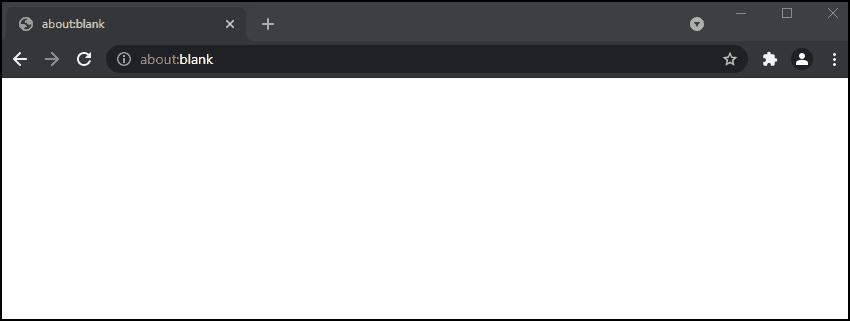

### Scraping this Web Page using Requests
Using the Requests method, only the first message gets scraped as the GET request happens instantaneously and hence the second message (which loads after a few seconds) is not scraped. 

In [1]:
import requests
from bs4 import BeautifulSoup

In [2]:
url = "https://pythonscraping.com/pages/javascript/ajaxDemo.html"
r = requests.get(url)
print("Status code: ", r)
soup = BeautifulSoup(r.text, "html.parser")
msg = soup.find("div").text
print(msg)
 

Status code:  <Response [200]>

This is some content that will appear on the page while it's loading. You don't care about scraping this.



### Scraping this Web Page using Selenium
With Selenium, the web browser can be automated to scrape the desired message after waiting for a few seconds.

In [4]:
from selenium import webdriver
import time 


In [6]:
# Create a driver object
driver = webdriver.Chrome()

In [7]:
driver.get(url) # Load the webpage
time.sleep(3) # Wait 3 seconds for the interesting content to load
soup = BeautifulSoup(driver.page_source, "html.parser")
msg = soup.find("div").text
print(msg)

Here is some important text you want to retrieve! A button to click!


In [8]:
# Close the driver
driver.close()

## 1.4 Example: Scraping the Reuters Website using Selenium

In this example, we will try and scrape the most recent 50 articles using the search query 'covid-19' from the [Reuters](https://www.reuters.com/search/news) website.

The animation below shows this process. 
- Type the url <https://reuters.com/search/news> in the address bar
- Scroll down to the bottom of the cookies pop-up and click 'Reject All'



<center>
    <div>
        <img src="Images\reuters_example_1.gif"/>
    </div>
</center>
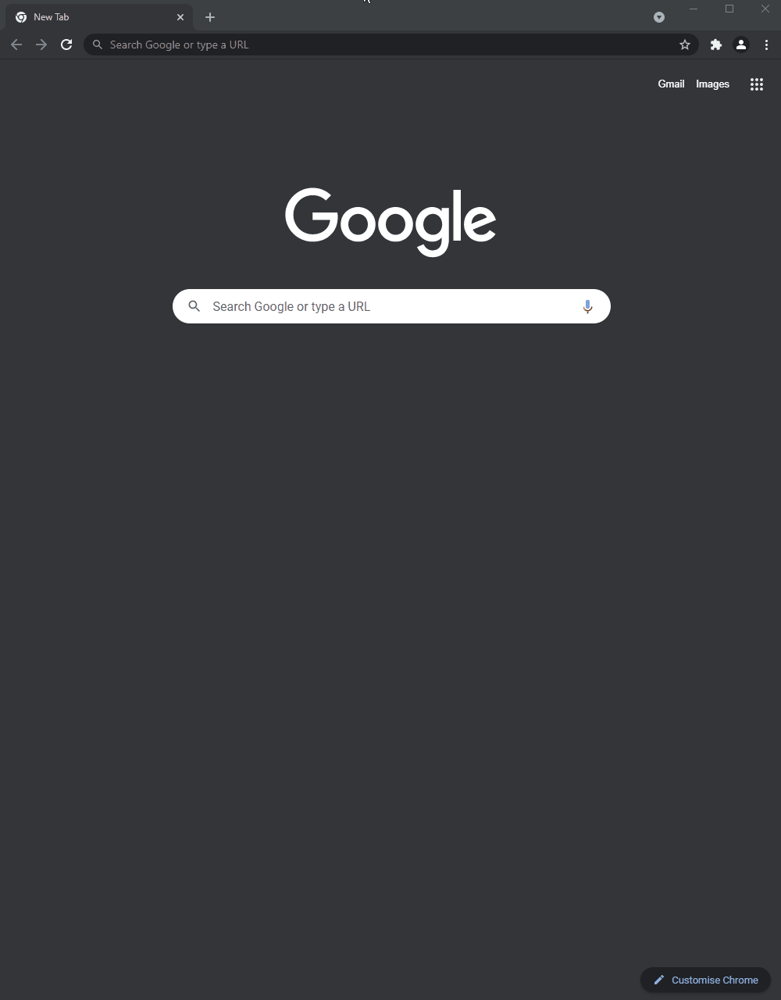

- Type covid-19 in the search box and hit Enter key
- The results are loaded 10 at a time. To view the first 50 results, we have to click on 'Load More Results' in the bottom of the page a few times. 

<center>
    <div>
        <img src="Images\reuters_example_2.gif"/>
    </div>
</center>
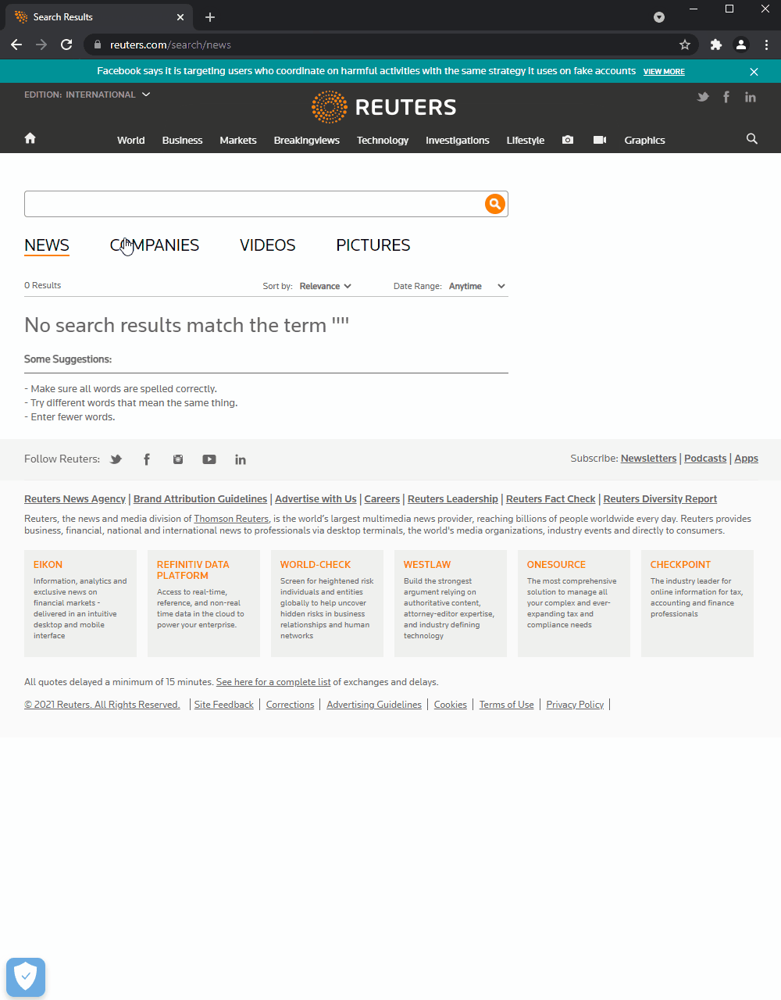

### Scraping using Requests <a class='tocSkip'>

In [13]:
url = "https://www.reuters.com/search/news?blob=wimbledon"
r = requests.get(url)
print("Status code: ", r.status_code)

soup = BeautifulSoup(r.text, "html.parser")
tag = "h3"
attributes = {"class": "search-result-title"}
results = [title.text for title in soup.find_all(tag, attributes)]
print("length of result: ", len(results))

Status code:  200
length of result:  10


Using Requests and BeautifulSoup only allows us to scrape the first 10 results that are initially shown on screen before we click on 'Load More Results' for the first time. In order to scrape more results, we have to use Selenium.

### Scraping using Selenium <a class='tocSkip'>

In [14]:
# Create the web driver
driver = webdriver.Chrome()

This opens a Chrome window that is controlled by the Selenium web driver. 

<center>
    <div>
        <img src="Images\reuters_example_3.png"/>
    </div>
</center>
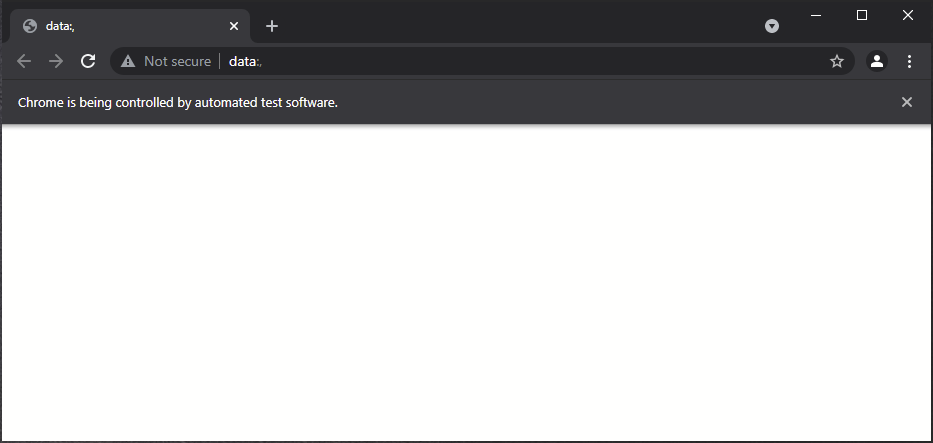

Now, running the following cells sequentially allows Selenium to issue the corresponding commands to this Chrome window.

In [15]:
url = "https://www.reuters.com/search/news"
driver.get(url)

This loads the webpage and shows the cookies pop-up as before.

<center>
    <div>
        <img src="Images\reuters_example_4.png"/>
    </div>
</center>
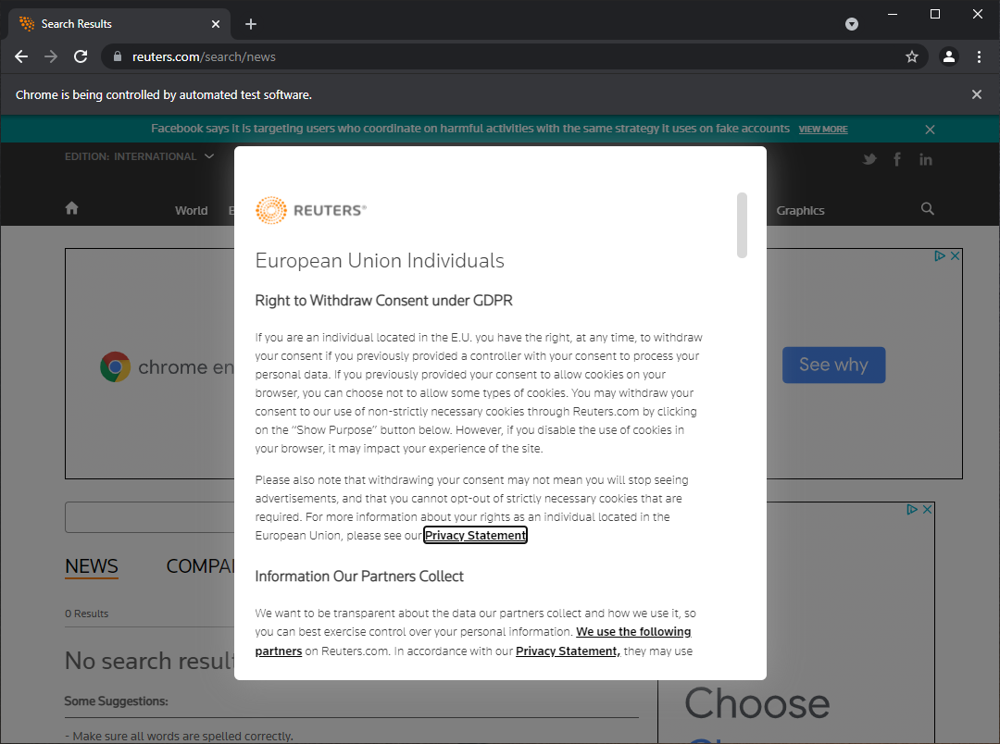

We will be locating and selecting elements in the webpage using their XPath expression. This allows us to navigate to different parts of the webpage by referencing the relative path of these elements based on XPath (XML Path Language). 

For more information on XPath, see: <https://www.w3schools.com/xml/xpath_intro.asp>

The XPath of an element can be copied by inspecting the element in the developer tools window. The animation below shows this process for finding the XPath of the 'Reject All' button. 

<center>
    <div>
        <img src="Images\reuters_example_5.gif"/>
    </div>
</center>
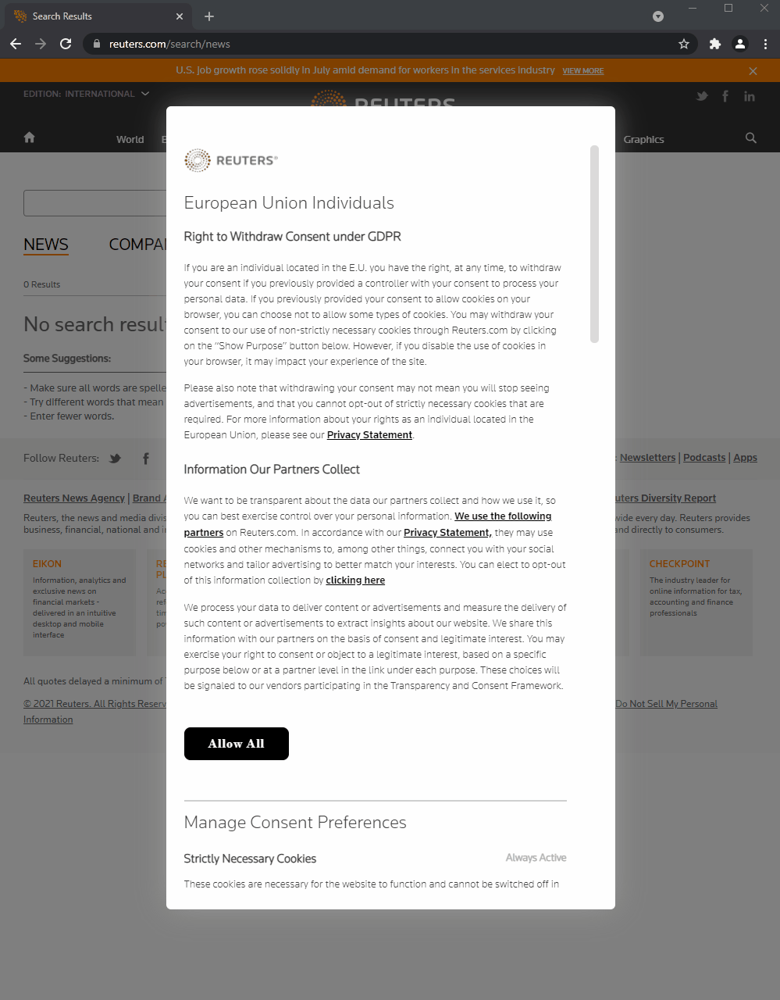

The copied xpath can then be used as an argument in `.find_element_by_xpath()` method to locate the element. This element can then be clicked using the `.click` method.

In [16]:
x_path_cookies_reject_1 = r'//*[@id="onetrust-pc-btn-handler"]'
driver.find_element("xpath", x_path_cookies_reject_1).click()

In [19]:
# Mini- ex: try and click reject all with selenium
x_path_cookies_reject_2 = '//*[@id="onetrust-pc-sdk"]/div[3]/div[1]/button[1]'
driver.find_element("xpath", x_path_cookies_reject_2).click()

Next, we find the xpath for the search box and use the `.send_keys()` method to send the keystrokes to this search box. In our case, it is the search term 'covid-19' followed by the ENTER key. In order to hit the ENTER key, we import the `Keys` module from `selenium.webdriver.common.keys` and use `Keys.ENTER` as our second argument.

In [21]:
x_path_search_box = '//*[@id="newsSearchField"]'

# Send the keystrokes 'wimbledon' followed by the enter key to this search 
from selenium.webdriver.common.keys import Keys
driver.find_element("xpath", x_path_search_box).send_keys("wimbledon", Keys.ENTER)

Now, we have to click the 'LOAD MORE RESULTS' button four times. Note that we add a small delay using `time.sleep` each time the button is clicked to allow for the results to load. 

In [22]:
x_path_load_results = '//*[@id="content"]/section[2]/div/div[1]/div[4]/div/div[4]/div[1]'

# Click the button 4 times, each time followed by a small delay of 2 seconds
driver.find_element("xpath", x_path_load_results).click()
time.sleep(2)
driver.find_element("xpath", x_path_load_results).click()
time.sleep(2)
driver.find_element("xpath", x_path_load_results).click()
time.sleep(2)
driver.find_element("xpath", x_path_load_results).click()
time.sleep(2)



Running the above cell will load the first 50 results on 'covid-19' in the webpage which then allows us to scrape the articles using BeautifulSoup.
<center>
    <div>
        <img src="Images\reuters_example_6.gif"/>
    </div>
</center>
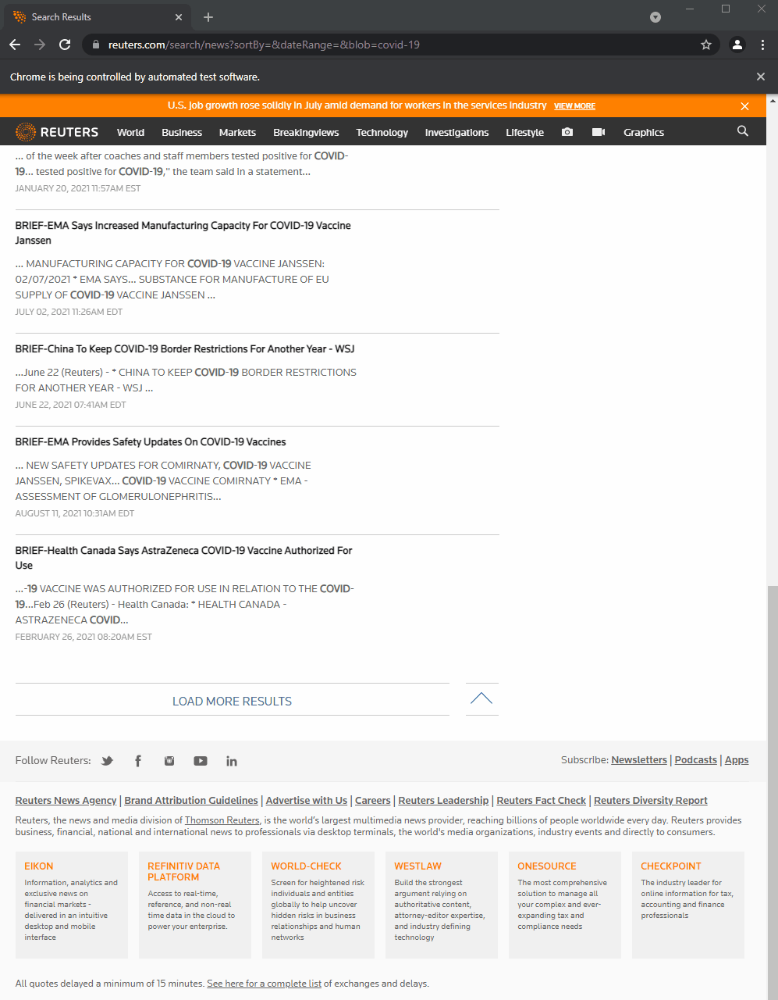

In [24]:
soup = BeautifulSoup(driver.page_source, "html.parser")


In [29]:
tag = "h3"
attributes = {"class" : "search-result-title"}
results = [title.text for i in soup.find_all(tag, attributes)]
print("Length of treuslts : ", len(results))

NameError: name 'title' is not defined

In [ ]:
driver.close()

In [25]:
links = [title.find("a"),["href"] for title in soup.find_all(tag, attributes)]
links = ["https"]

SyntaxError: invalid syntax (4200053062.py, line 1)

Do it all at once

In [ ]:
# Create the web driver
driver = webdriver.Chrome()

url = "https://www.reuters.com/search/news"
driver.get(url)

# Reject cookies
x_path_cookies_reject_1 = '//*[@id="onetrust-pc-btn-handler"]'
driver.find_element("xpath", x_path_cookies_reject_1).click()

x_path_cookies_reject_2 = '//*[@id="onetrust-pc-sdk"]/div[3]/div[1]/button[1]'
driver.find_element("xpath", x_path_cookies_reject_2).click()

# Send the keystrokes 'wimbledon' followed by the enter key to this search box
x_path_search_box = '//*[@id="newsSearchField"]'

from selenium.webdriver.common.keys import Keys
driver.find_element("xpath", x_path_search_box).send_keys("wimbledon", Keys.ENTER)

x_path_more = '//*[@id="content"]/section[2]/div/div[1]/div[4]/div/div[4]/div[1]'

# Click the button 4 times, each time followed by a small delay of 2 seconds
driver.find_element("xpath", x_path_more).click()
time.sleep(2)
driver.find_element("xpath", x_path_more).click()
time.sleep(2)
driver.find_element("xpath", x_path_more).click()
time.sleep(2)
driver.find_element("xpath", x_path_more).click()
time.sleep(2)

# Capture the page source at the right place
soup = BeautifulSoup(driver.page_source, "html.parser")